In [ ]:
!pip install tensorflow==2.10.0
!pip install Keras-Applications=== 1.0.7
!pip install image-classifiers == 1.0
!pip install efficientnet == 1.0


In [ ]:
!pip install -U segmentation-models

In [ ]:
import segmentation_models as sm
import tensorflow as tf
from tensorflow import keras 

In [ ]:
import os
from google.colab import drive
drive.mount('/content/drive/')


Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:

from google.colab import drive
!gdown "https://drive.google.com/u/0/uc?id=1UujK-kXOhCcjMt0S5OJIcu7SNWyGFEsy&export=download" 
!unzip "archive (1).zip"


In [ ]:
import cv2
import matplotlib.patches as mpatches
import numpy as np
import os
import pandas as pd
import random
import seaborn as sns
import segmentation_models as sm
import tqdm
from tensorflow.keras.callbacks import ModelCheckpoint
from keras.utils import to_categorical
from sklearn.preprocessing import MinMaxScaler
from matplotlib import pyplot as plt
from tensorflow.keras.metrics import MeanIoU, IoU
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix
from collections import Counter
from tensorflow.experimental.numpy import ravel
from tensorflow import stack, cast, int32, make_ndarray

Segmentation Models: using `keras` framework.


In [ ]:
!gdown https://drive.google.com/drive/u/1/my-drive
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

In [ ]:
BACKBONE = 'mobilenet'

preprocess_input = sm.get_preprocessing(BACKBONE)
BATCH_SIZE = 64
SEED = 42
RAW_N_CLASSES = 16
N_CLASSES = 14

In [ ]:
import tensorflow  as tf

In [ ]:
def merge_classes(mask, cls1, cls2, raw_num_classes=RAW_N_CLASSES):
    mask[mask == cls1] = cls2
    for i in range(cls1 + 1, raw_num_classes):
        mask[mask==i] = i - 1
    return mask

def preprocess_data(img, mask, num_class):
    img = preprocess_input(img)
    
    # merge some classes
    mask = merge_classes(mask, 7, 6)
    mask = merge_classes(mask, 13, 12)
    mask = to_categorical(mask, num_class)
    return (img, mask)

def trainGenerator(train_img_path, train_mask_path, num_class, aug=True, show_raw=False):
    s=0
    img_data_gen_args = dict(horizontal_flip=True,
                      vertical_flip=True,
                      fill_mode='reflect')
    if aug:
        image_datagen = ImageDataGenerator(**img_data_gen_args)
        mask_datagen = ImageDataGenerator(**img_data_gen_args)
    else:
        image_datagen = ImageDataGenerator()
        mask_datagen = ImageDataGenerator()
    
    image_generator = image_datagen.flow_from_directory(
        train_img_path,
        class_mode = None,
        batch_size = BATCH_SIZE,
        seed = SEED)
    print(image_generator)
    mask_generator = mask_datagen.flow_from_directory(
        train_mask_path,
        class_mode = None,
        color_mode = 'grayscale',
        batch_size = BATCH_SIZE,
        seed = SEED)
    print(mask_generator)
    train_generator = zip(image_generator, mask_generator)
    s=0
    for (img, mask) in train_generator:
        if show_raw:
            raw_img = np.copy(img)
            img, mask = preprocess_data(img, mask, num_class)
            img = np.stack((img, raw_img), axis=-1)
            if s<=5000:
             yield (img, mask)
             s+=1
            else:
              break
            
        else:
            img, mask = preprocess_data(img, mask, num_class)
            yield (img, mask)


def show_mask_with_label(batch, labels, _min, _max, alpha=1):
    values, counts = np.unique(batch, return_counts=True)
    counts = counts / (256*256)
    im = plt.imshow(batch, cmap='viridis', vmin = _min, vmax = _max, alpha=alpha)
    colors = [im.cmap(im.norm(value)) for value in values]
    
    patches = [mpatches.Patch(color=colors[i], label=labels[values[i]]) \
               for i in range(len(values)) if counts[i] > 0.005]
    plt.legend(handles=patches)

In [ ]:
def trainGenerator1(train_img_path,train_mask_path, num_class):
    
    img_data_gen_args = dict(horizontal_flip=True,
                      vertical_flip=True,
                      fill_mode='reflect')
    
    image_datagen = ImageDataGenerator(**img_data_gen_args)
    mask_datagen = ImageDataGenerator(**img_data_gen_args)
    
    image_generator = image_datagen.flow_from_directory(
        train_img_path,
        class_mode = None,
        batch_size = BATCH_SIZE,
        seed = SEED)
    
    mask_generator = mask_datagen.flow_from_directory(
        train_mask_path,
        class_mode = None,
        color_mode = 'grayscale',
        batch_size = BATCH_SIZE,
        seed = SEED)
    
    train_generator = zip(image_generator, mask_generator)
    
    for (img, mask) in train_generator:
        img, mask = preprocess_data(img, mask, num_class)
        yield (img, mask)


In [ ]:
kaggle_path = 'data/'
labels = ['background','industrial land',
          'urban residential','rural residential',
          'traffic land','paddy field','irrigated land', 'dry cropland',
          'garden plot','arbor woodland',
          'shrub land','natural grassland',
          'artificial grassland','river', 'lake','pond']

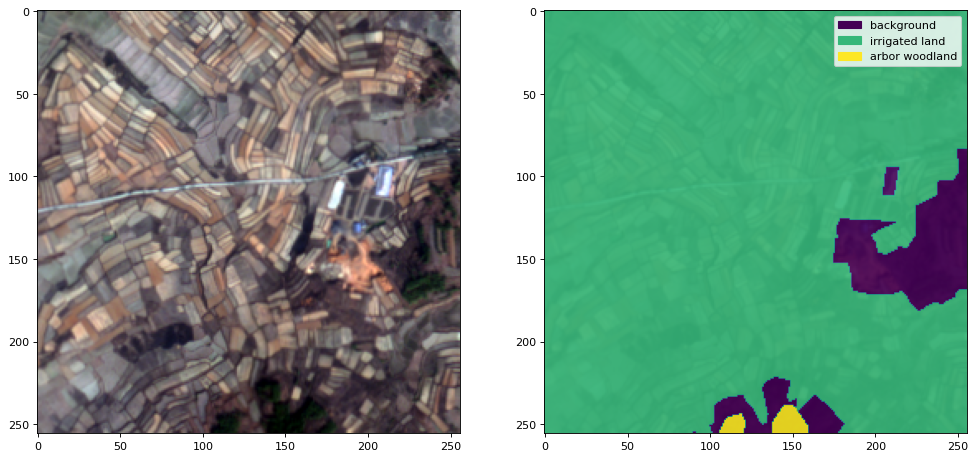

In [ ]:
train_img_dir = kaggle_path + "data_for_keras_aug/train_images/train/"
train_mask_dir = kaggle_path + "data_for_keras_aug/train_masks/train/"

img_list = os.listdir(train_img_dir)
msk_list = os.listdir(train_mask_dir)

img_list.sort()
msk_list.sort()

num_images = len(os.listdir(train_img_dir))
img_num = random.randint(0, num_images - 1)

img_for_plot = cv2.imread(train_img_dir+img_list[img_num], 1)
img_for_plot = cv2.cvtColor(img_for_plot, cv2.COLOR_BGR2RGB)

mask_for_plot = cv2.imread(train_mask_dir+msk_list[img_num], 0)

_min, _max = np.amin(mask_for_plot), np.amax(mask_for_plot)

plt.figure(figsize=(15, 15), dpi=80)

plt.subplot(1,2,1)
plt.imshow(img_for_plot.astype('uint8'))

plt.subplot(1,2,2)
plt.imshow(img_for_plot.astype('uint8'))

plt.subplot(1,2,2)
show_mask_with_label(mask_for_plot, labels, _min, _max, alpha=0.9) # add some opacity  

plt.show()

In [ ]:
train_img_path = kaggle_path + "data_for_keras_aug/train_images/"
train_mask_path = kaggle_path + "data_for_keras_aug/train_masks/"
train_img_gen = trainGenerator(train_img_path, train_mask_path, num_class=N_CLASSES)

val_img_path = kaggle_path + "data_for_keras_aug/val_images/"
val_mask_path = kaggle_path + "data_for_keras_aug/val_masks/"
val_img_gen = trainGenerator(val_img_path, val_mask_path, num_class=N_CLASSES)

Found 35292 images belonging to 1 classes.
Found 35291 images belonging to 1 classes.


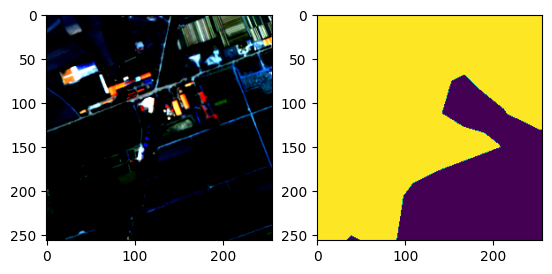

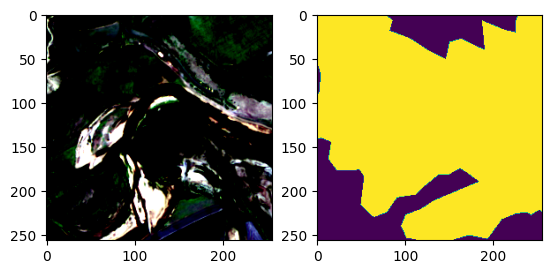

In [ ]:
def show_examples(generator):
    x, y = generator.__next__()
    for i in range(0,2):
        image = x[i]
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        mask = np.argmax(y[i], axis=2)
        plt.subplot(1,2,1)
        plt.imshow(image)
        plt.subplot(1,2,2)
        plt.imshow(mask, cmap='viridis')
        plt.show()
    return x, y

x, y = show_examples(train_img_gen)

In [ ]:
num_train_imgs = len(os.listdir(train_img_path + "/train"))
num_val_images = len(os.listdir(val_img_path + "/val"))

steps_per_epoch = num_train_imgs // BATCH_SIZE
val_steps_per_epoch = num_val_images // BATCH_SIZE

IMG_HEIGHT = x.shape[1]
IMG_WIDTH  = x.shape[2]
IMG_CHANNELS = x.shape[3]

In [ ]:
model1 = sm.Unet(BACKBONE, encoder_weights='imagenet',
  input_shape=(IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS),
  classes=N_CLASSES, activation='softmax')
model1.compile('Adam', loss=sm.losses.categorical_focal_jaccard_loss, metrics=[sm.metrics.iou_score])

/usr/local/lib/python3.9/dist-packages/keras_applications/mobilenet.py:207: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  warnings.warn('`input_shape` is undefined or non-square, '


In [ ]:


#Other losses to try: categorical_focal_dice_loss, cce_jaccard_loss, cce_dice_loss, categorical_focal_loss

#model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=metrics)
# print(model.summary())
# print(model.input_shape)
#Fit the model
#history = model.fit(my_generator, validation_data=validation_datagen, steps_per_epoch=len(X_train) // 16, validation_steps=len(X_train) // 16, epochs=100)
#Train the model.
history=model1.fit(train_img_gen,
  steps_per_epoch=steps_per_epoch,
  epochs=35,
  verbose=1,
  validation_data=val_img_gen,
 validation_steps=val_steps_per_epoch)

model1.save('_35_epochs_.hdf5')

NameError: ignored

In [ ]:
from keras.models import load_model 


In [ ]:
s='/content/drive/MyDrive/Colab Notebooks/_15_epochs_ (1).hdf5'

# satellite_model = load_model(s)
model = load_model(s, compile=False)


Found 6920 images belonging to 1 classes.
Found 6920 images belonging to 1 classes.
2/2 [==============================] - 21s 10s/step
Mean IoU = 0.43070528


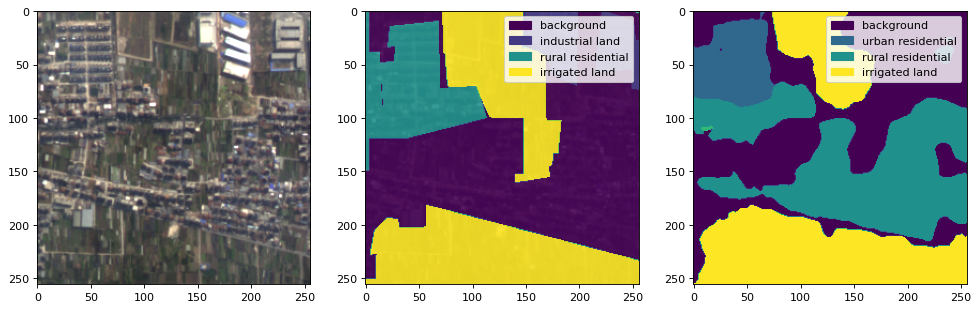

2/2 [==============================] - 23s 15s/step
Mean IoU = 0.4824932


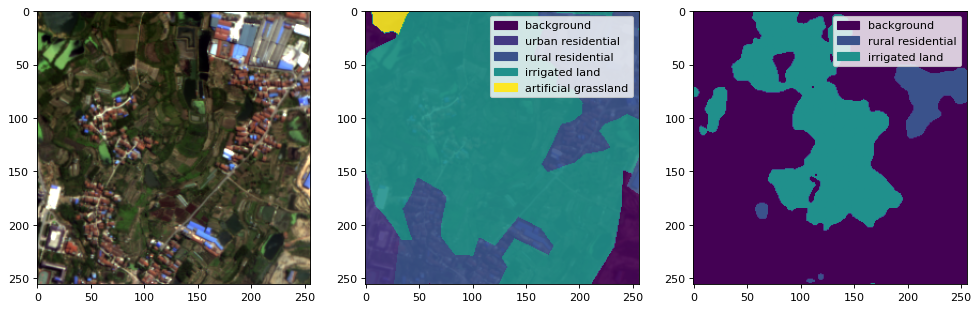

2/2 [==============================] - 19s 8s/step
Mean IoU = 0.4424324


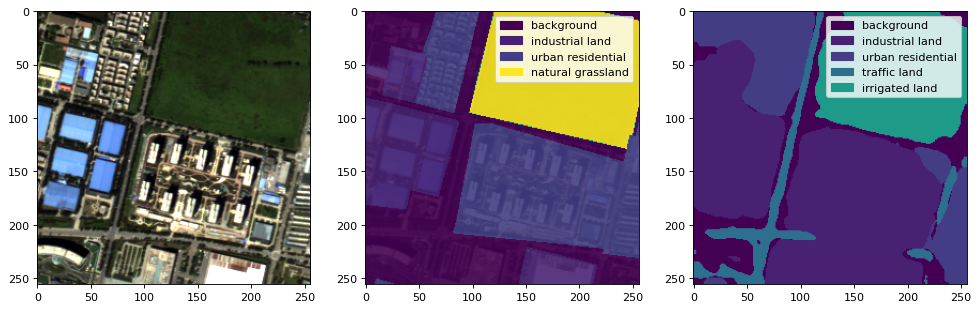

2/2 [==============================] - 23s 11s/step
Mean IoU = 0.4445814


In [ ]:
eval_preds_img_gen = trainGenerator(val_img_path, val_mask_path, num_class=N_CLASSES, show_raw=True)
test_image_batch, test_mask_batch = eval_preds_img_gen.__next__()
test_mask_batch_argmax = np.argmax(test_mask_batch, axis=3)

test_pred_batch = model.predict(test_image_batch[:, :, :, :, 0])
test_pred_batch_argmax = np.argmax(test_pred_batch, axis=3)


IOU_keras = MeanIoU(num_classes=N_CLASSES, ignore_class=[0]) 
IOU_keras.update_state(test_pred_batch_argmax, test_mask_batch_argmax)
print("Mean IoU =", IOU_keras.result().numpy())

img_num = random.randint(0, test_image_batch.shape[0]-4)

for i in range(0, 3):
  combined_data = np.array(list(np.unique(test_mask_batch_argmax[img_num+i])) + list(np.unique(test_pred_batch_argmax[img_num+i])))
  _min, _max = np.amin(combined_data), np.amax(combined_data)
  plt.figure(figsize=(15, 15), dpi=80)

  plt.subplot(1,3,1)
  plt.imshow(test_image_batch[:, :, :, :, 1][img_num+i].astype('uint8'))

  plt.subplot(1,3,2)
  plt.imshow(test_image_batch[:, :, :, :, 1][img_num+i].astype('uint8'))
  plt.subplot(1,3,2)
  show_mask_with_label(test_mask_batch_argmax[img_num+i], labels, _min, _max, alpha=0.9)

  plt.subplot(1,3,3)
  show_mask_with_label(test_pred_batch_argmax[img_num+i], labels, _min, _max)
  plt.show()
  test_image_batch, test_mask_batch = eval_preds_img_gen.__next__()
  test_mask_batch_argmax = np.argmax(test_mask_batch, axis=3)

  test_pred_batch = model.predict(test_image_batch[:, :, :, :, 0])
  test_pred_batch_argmax = np.argmax(test_pred_batch, axis=3)


  IOU_keras = MeanIoU(num_classes=N_CLASSES, ignore_class=[0]) # you can ignore "background" class
  IOU_keras.update_state(test_pred_batch_argmax, test_mask_batch_argmax)
  print("Mean IoU =", IOU_keras.result().numpy())

  img_num = random.randint(0, test_image_batch.shape[0]-4)



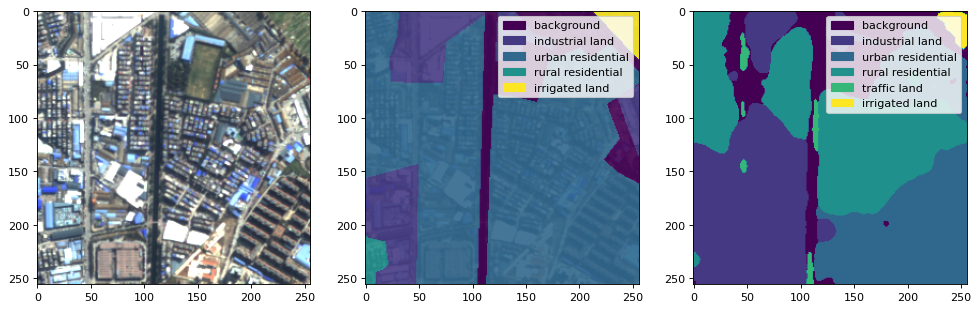

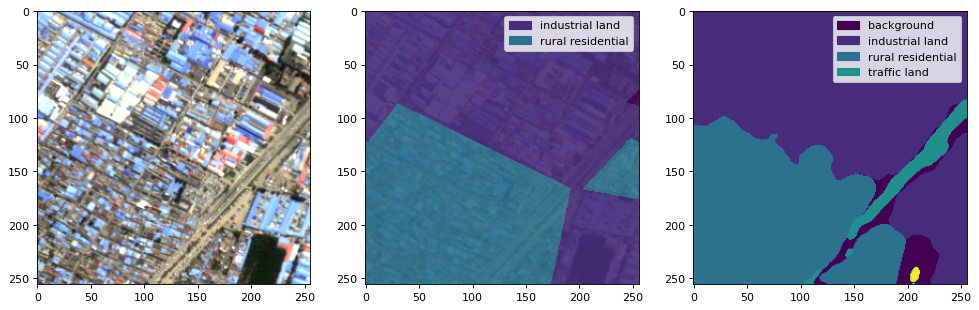

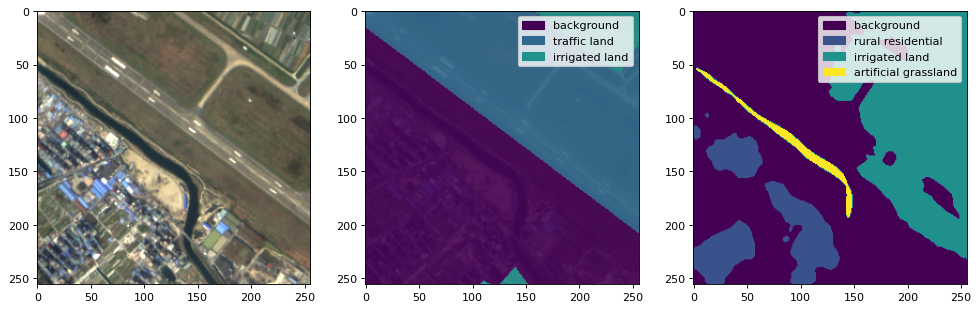

In [ ]:
for i in range(0, 3):
 combined_data = np.array(list(np.unique(test_mask_batch_argmax[img_num+i])) + list(np.unique(test_pred_batch_argmax[img_num+i])))
 _min, _max = np.amin(combined_data), np.amax(combined_data)
 plt.figure(figsize=(15, 15), dpi=80)

 plt.subplot(1,3,1)
 plt.imshow(test_image_batch[:, :, :, :, 1][img_num+i].astype('uint8'))

 plt.subplot(1,3,2)
 plt.imshow(test_image_batch[:, :, :, :, 1][img_num+i].astype('uint8'))
 plt.subplot(1,3,2)
 show_mask_with_label(test_mask_batch_argmax[img_num+i], labels, _min, _max, alpha=0.9)

 plt.subplot(1,3,3)
 show_mask_with_label(test_pred_batch_argmax[img_num+i], labels, _min, _max)
 plt.show()

Found 65 images belonging to 1 classes.
Found 1 images belonging to 2 classes.
2/2 [==============================] - 20s 10s/step


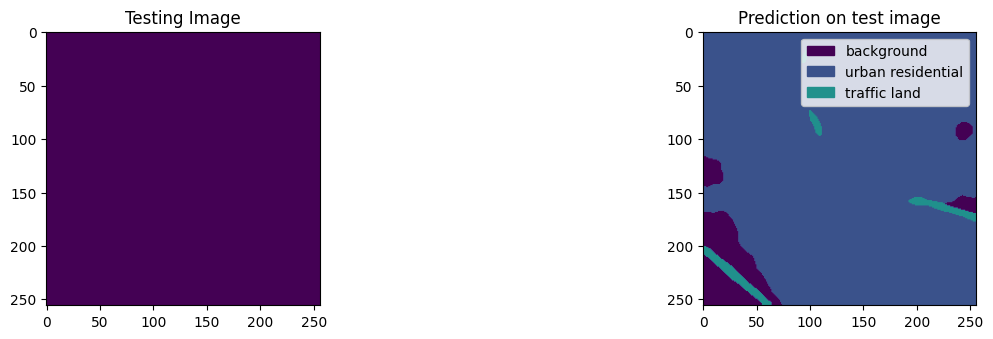

In [ ]:
eval_preds_img_gen = trainGenerator("/content/drive/MyDrive/Colab Notebooks/11/1","1", num_class=N_CLASSES)
test_image_batch, test_mask_batch = eval_preds_img_gen.__next__()




test_pred_batch = model.predict(test_image_batch)




img_num = random.randint(0, test_image_batch.shape[0]-1)
combined_data = np.array(list(np.unique(test_mask_batch_argmax[img_num])) + list(np.unique(test_pred_batch_argmax[img_num])))
_min, _max = np.amin(combined_data), np.amax(combined_data)


plt.figure(figsize=(12, 8))
plt.subplot(231)
plt.title('Testing Image')
plt.imshow(test_image_batch[:, :, :,  1][img_num].astype('uint8'))

plt.subplot(233)
plt.title('Prediction on test image')
plt.imshow(test_pred_batch_argmax[img_num], cmap='viridis')
show_mask_with_label(test_pred_batch_argmax[img_num+i], labels, _min, _max)

plt.show()






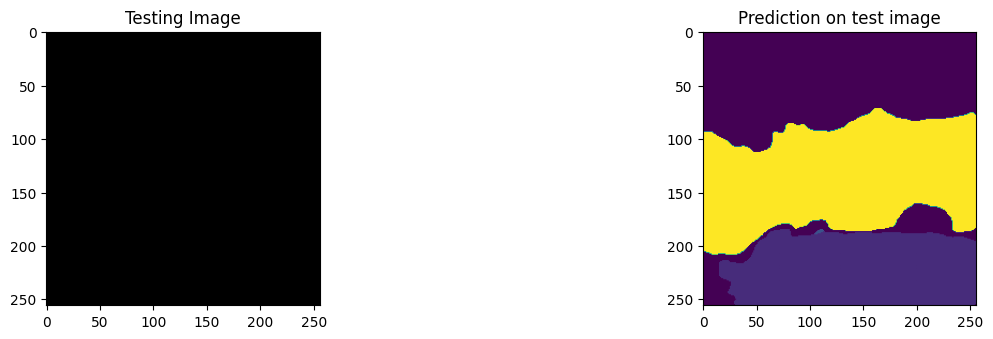

In [ ]:
plt.figure(figsize=(12, 8))
plt.subplot(231)
plt.title('Testing Image')
plt.imshow(test_image_batch[:, :, :,  :][img_num])
# plt.subplot(232)
# plt.title('Testing Label')
# plt.imshow(test_mask_batch_argmax[img_num])
plt.subplot(233)
plt.title('Prediction on test image')
plt.imshow(test_pred_batch_argmax[img_num], cmap='viridis')
plt.show()


In [ ]:
for i in range(0, 3):
 combined_data = np.array(list(np.unique(test_mask_batch_argmax[img_num+i])) + list(np.unique(test_pred_batch_argmax[img_num+i])))
 _min, _max = np.amin(combined_data), np.amax(combined_data)
 plt.figure(figsize=(15, 15), dpi=80)

 plt.subplot(1,3,1)
 plt.imshow(test_image_batch[:, :, :, :, 1][img_num+i].astype('uint8'))

 plt.subplot(1,3,2)
 plt.imshow(test_image_batch[:, :, :, :, 1][img_num+i].astype('uint8'))
 plt.subplot(1,3,2)
 show_mask_with_label(test_mask_batch_argmax[img_num+i], labels, _min, _max, alpha=0.9)

 plt.subplot(1,3,3)
 show_mask_with_label(test_pred_batch_argmax[img_num+i], labels, _min, _max)
 plt.show()

IndexError: ignored

In [ ]:
len(test_pred_batch_argmax)

64

1
Found 65 images belonging to 1 classes.
Found 1 images belonging to 2 classes.
2/2 [==============================] - 20s 10s/step


64


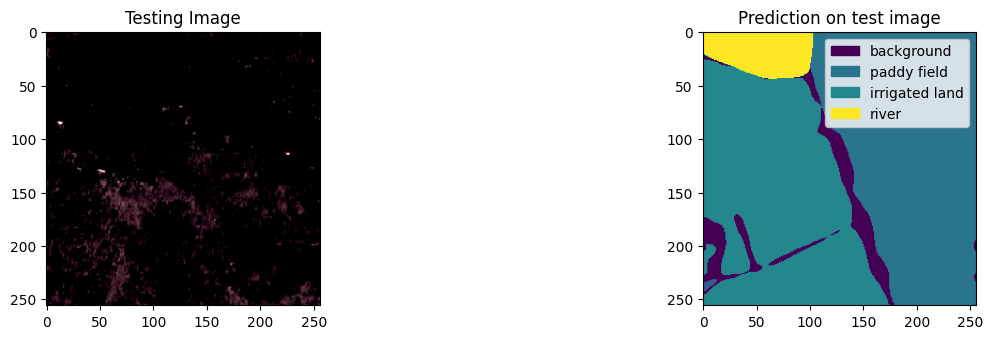

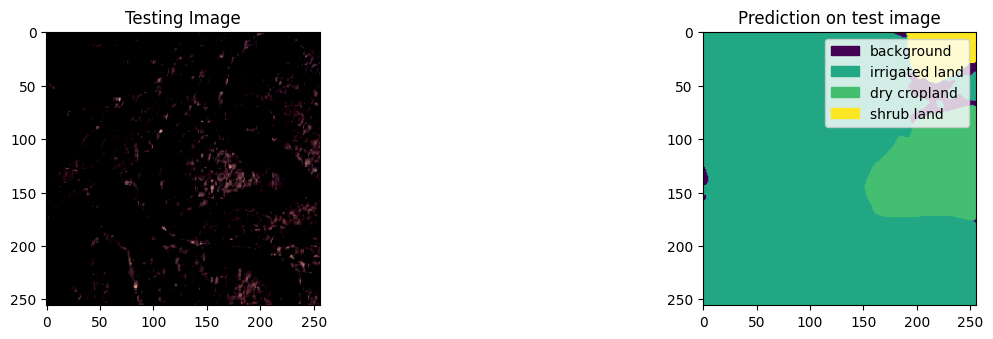

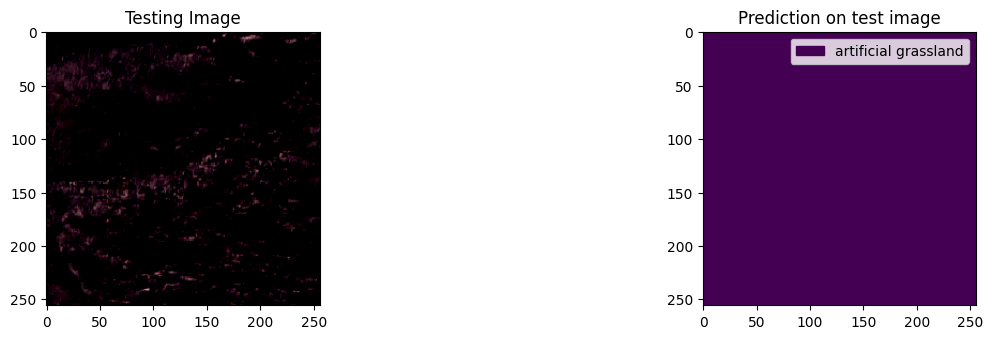

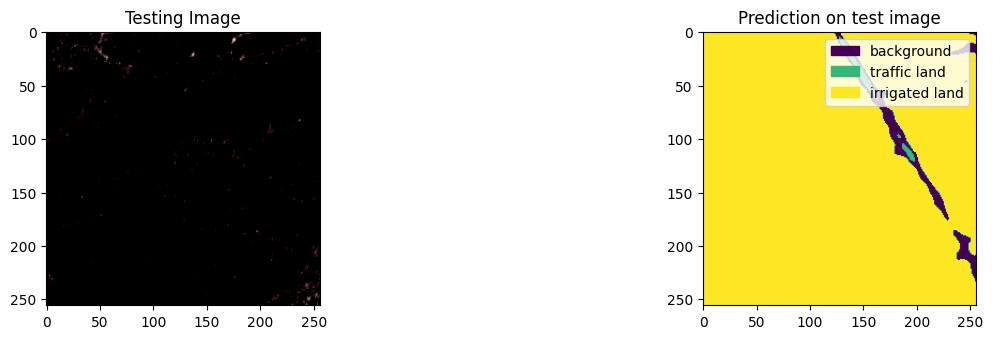

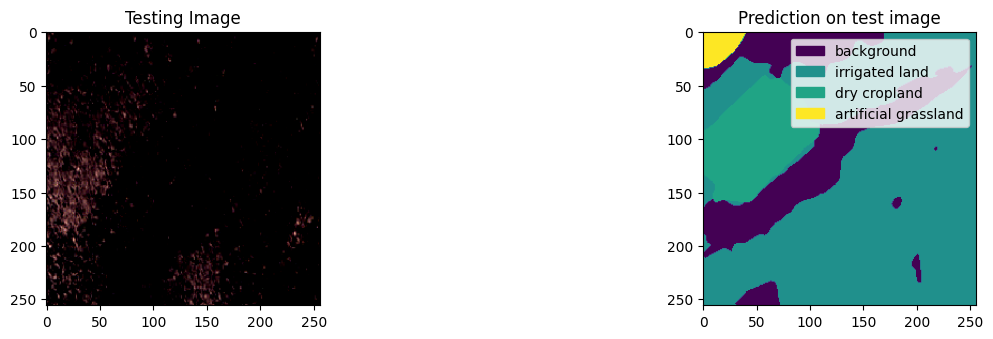

...

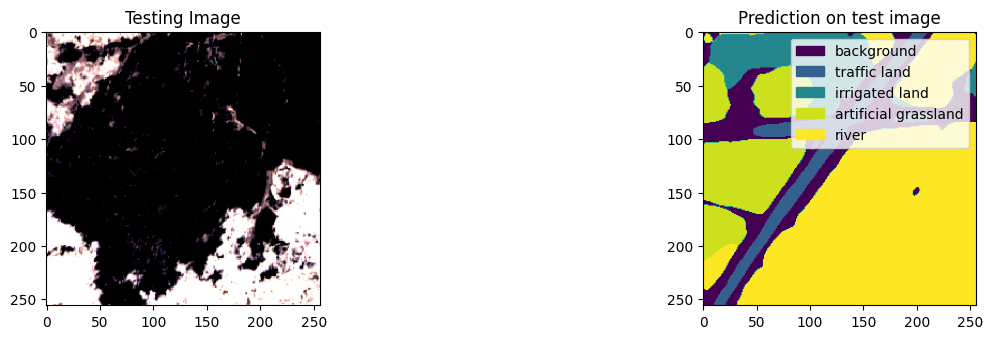

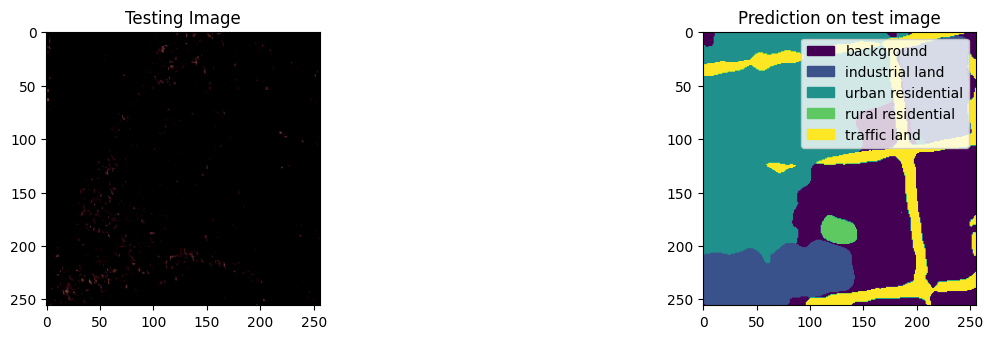

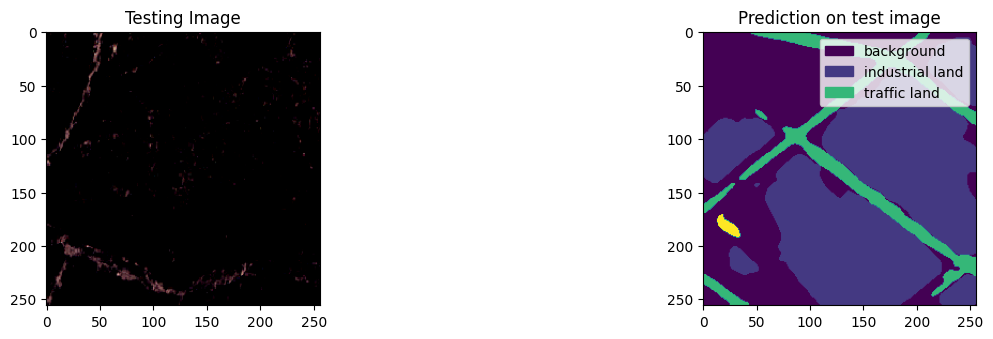

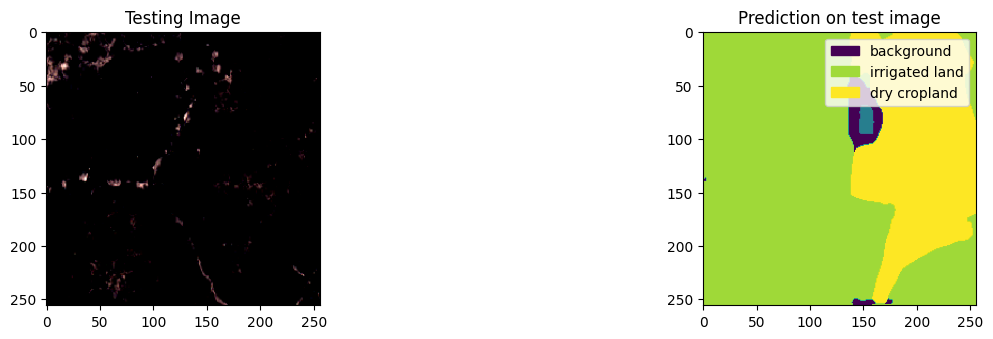

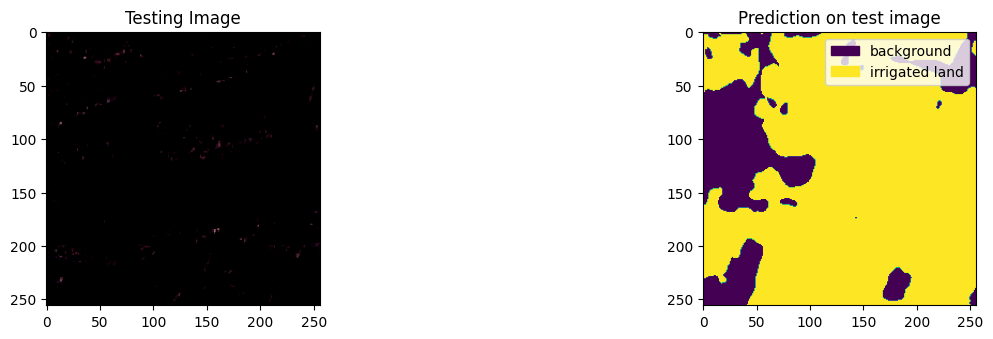

2
Found 64 images belonging to 1 classes.
Found 1 images belonging to 2 classes.
2/2 [==============================] - 20s 8s/step


64


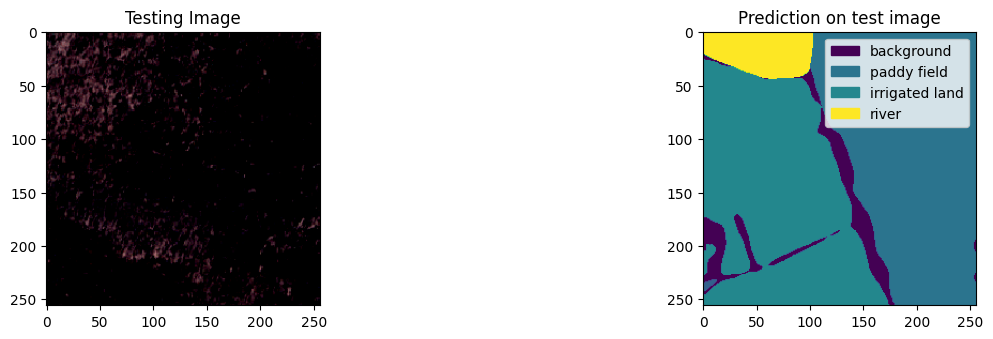

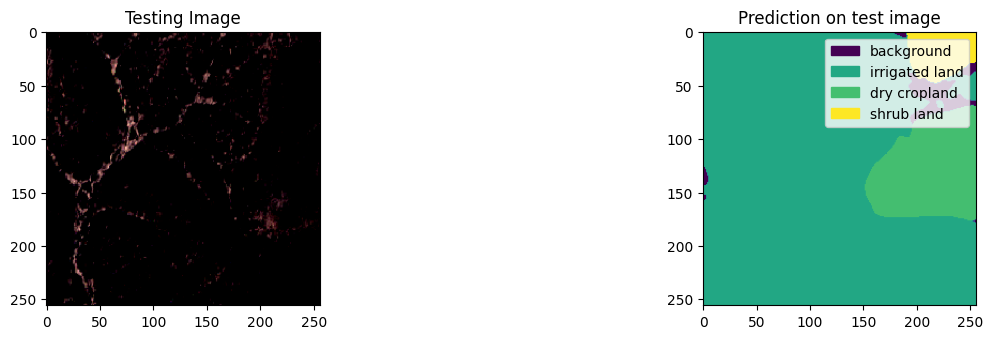

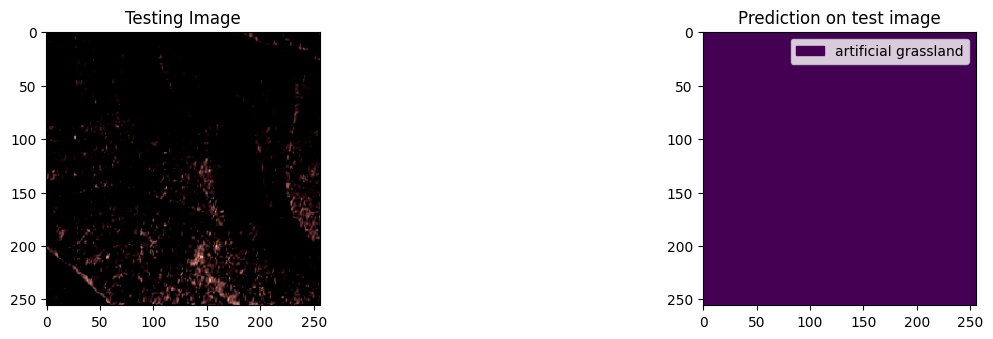

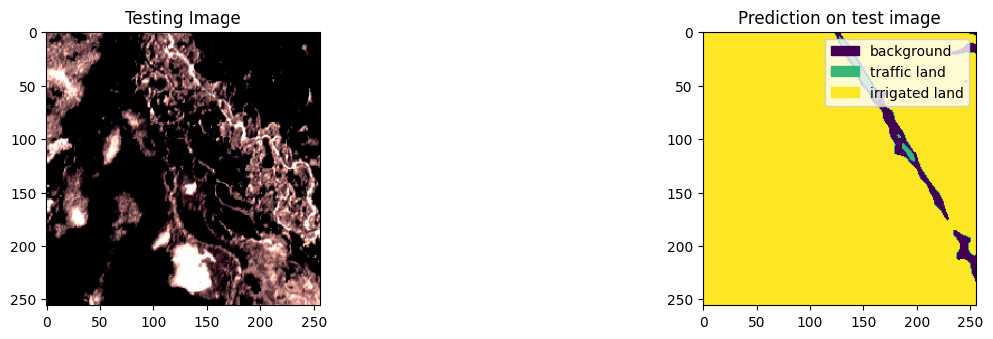

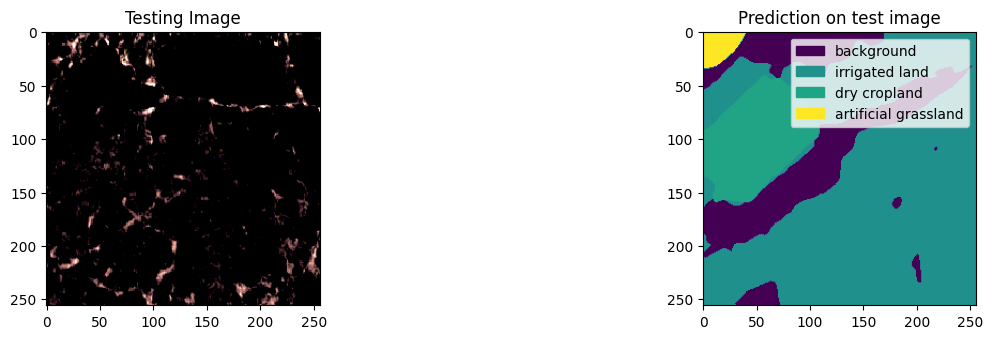

...

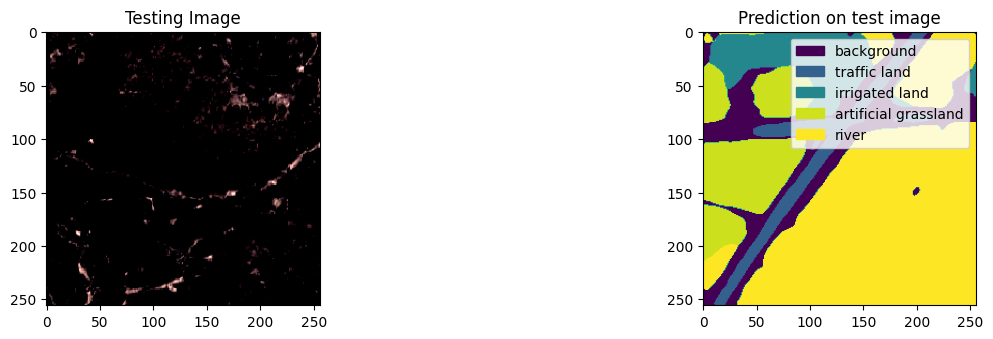

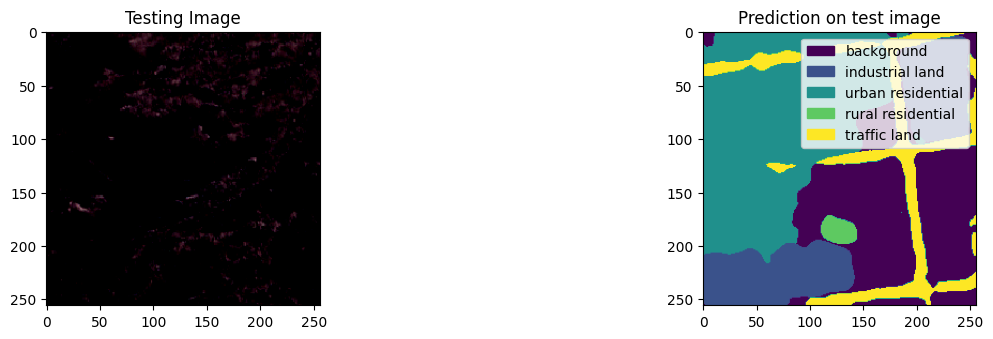

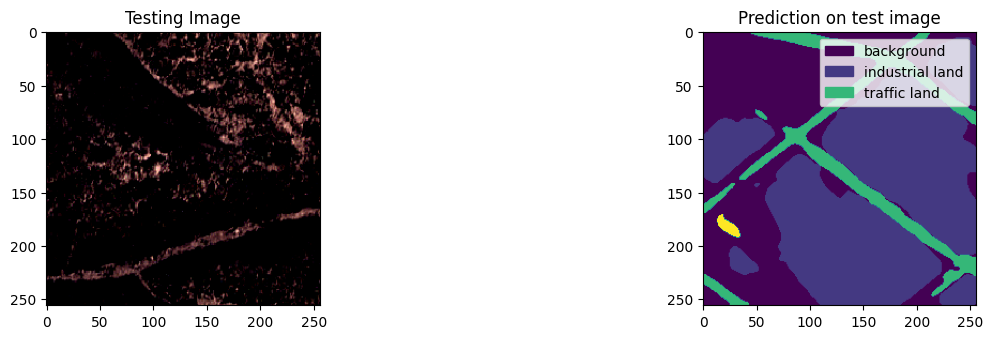

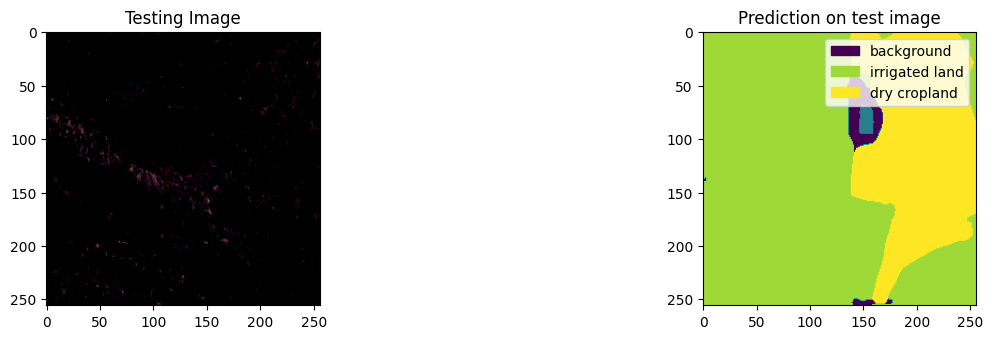

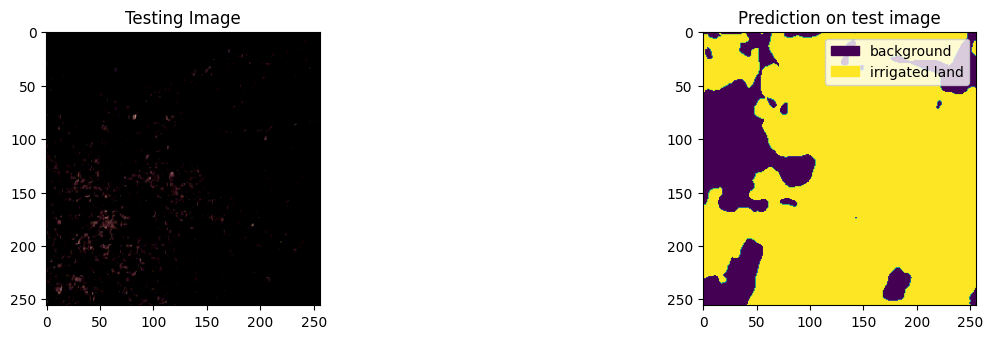

3
Found 64 images belonging to 1 classes.
Found 1 images belonging to 2 classes.
2/2 [==============================] - 20s 8s/step


64


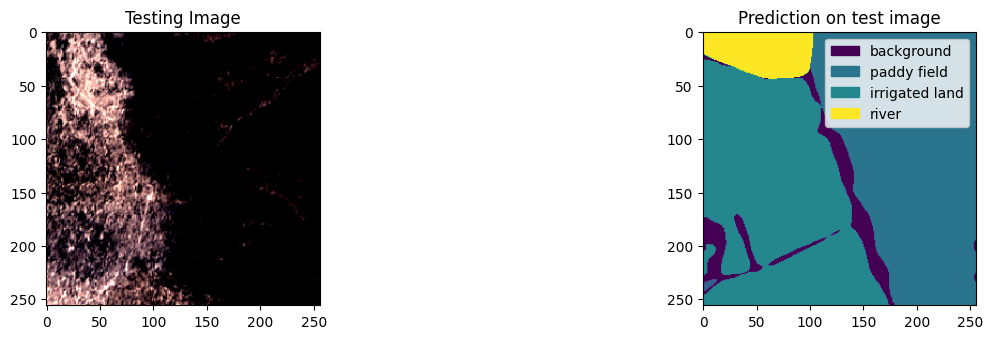

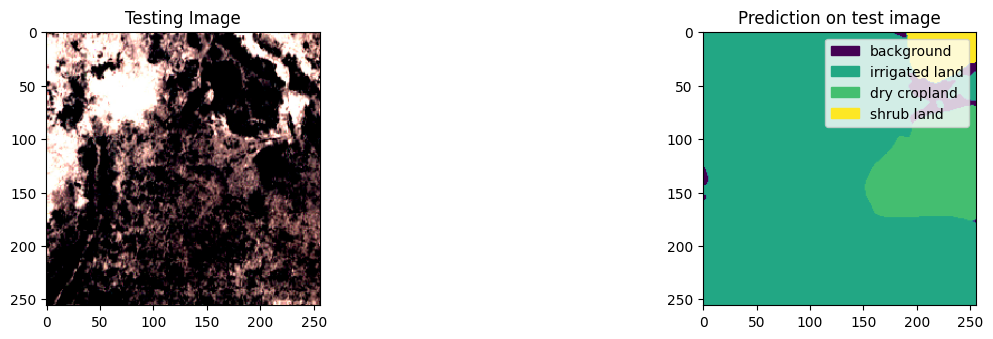

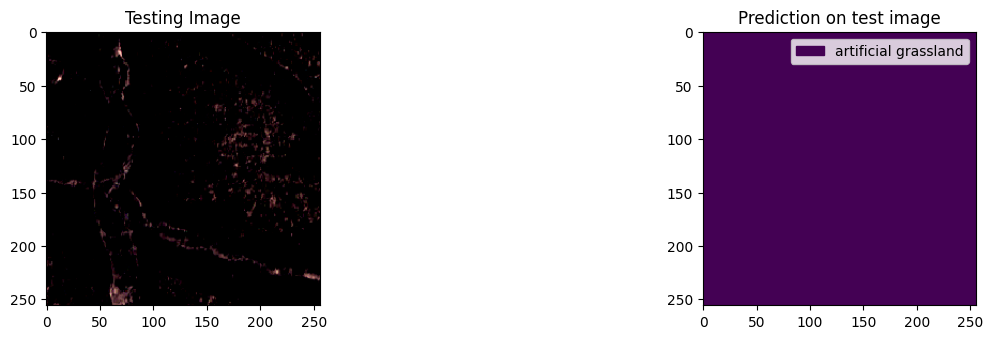

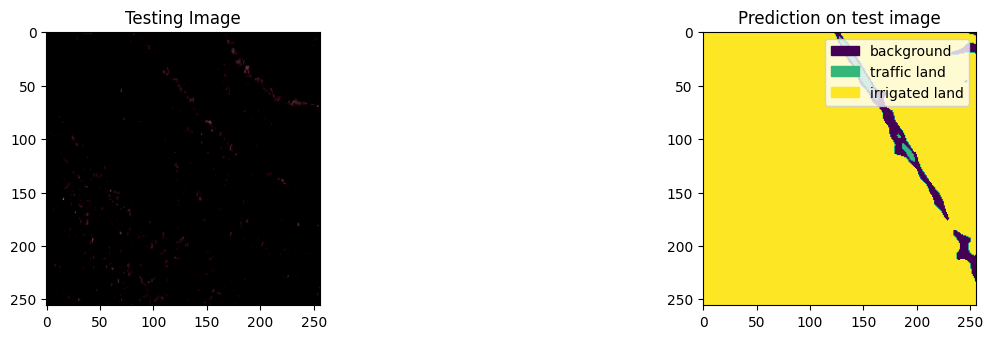

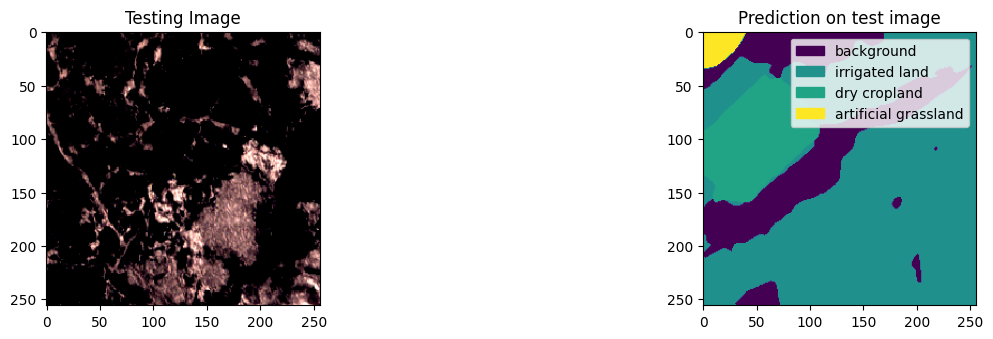

...

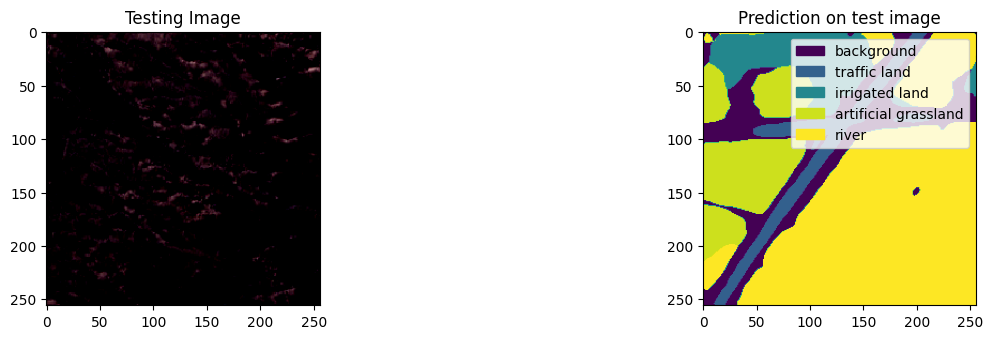

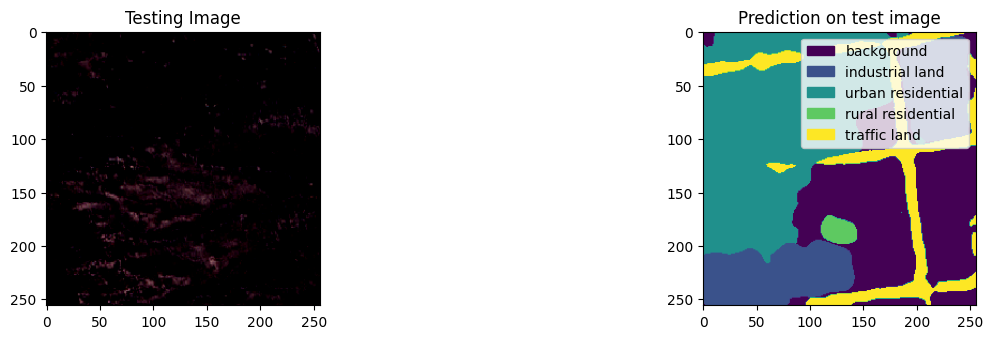

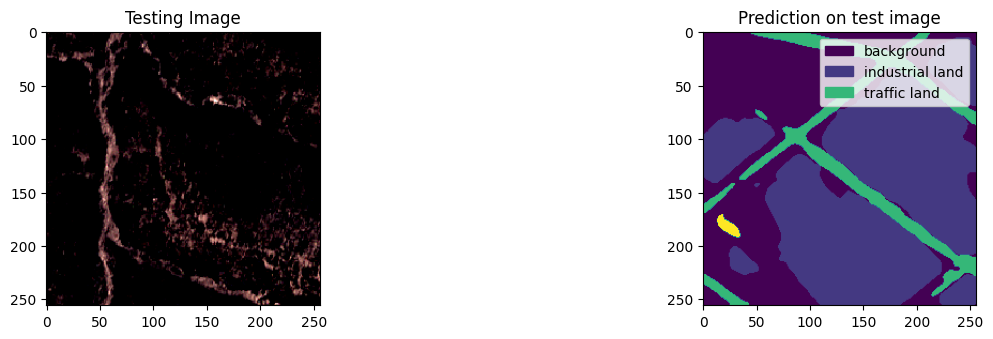

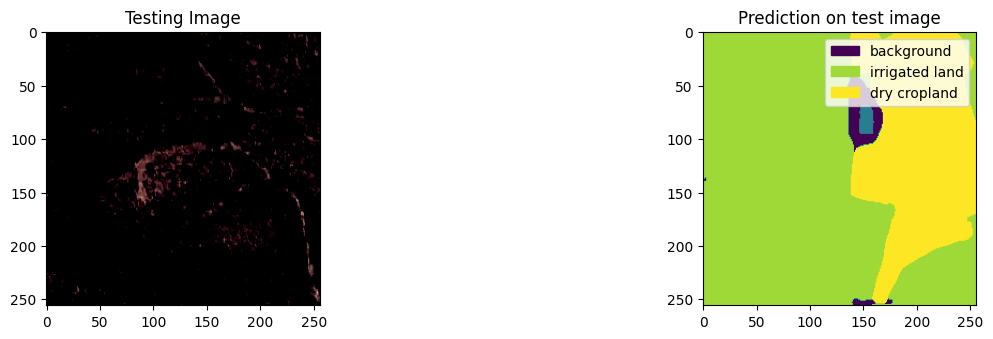

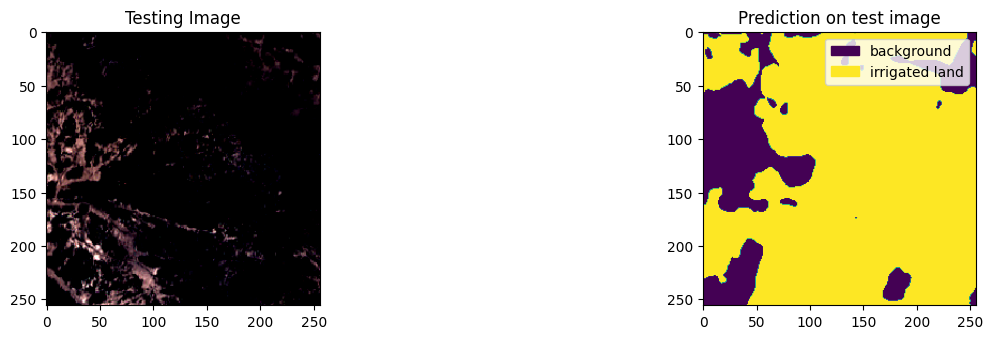

4
Found 64 images belonging to 1 classes.
Found 1 images belonging to 2 classes.
2/2 [==============================] - 23s 9s/step


64


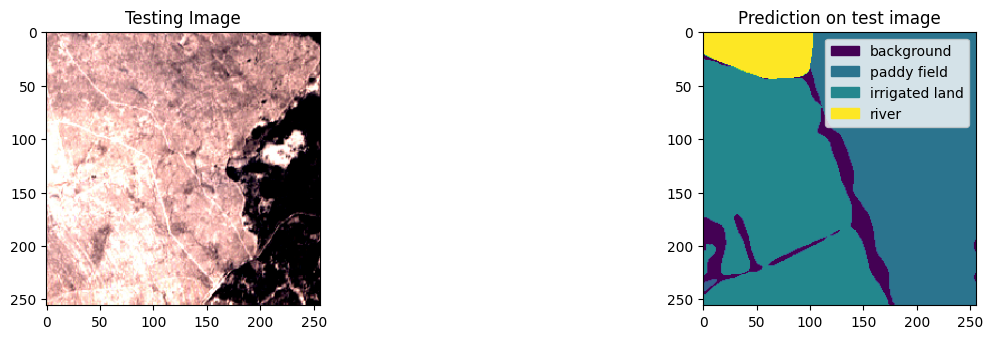

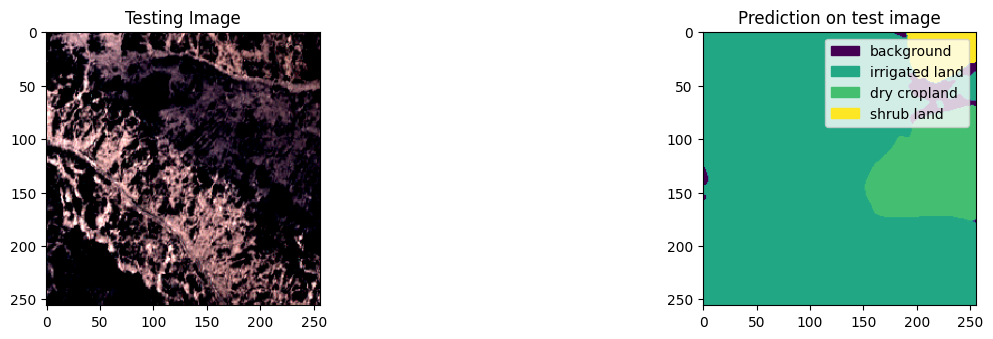

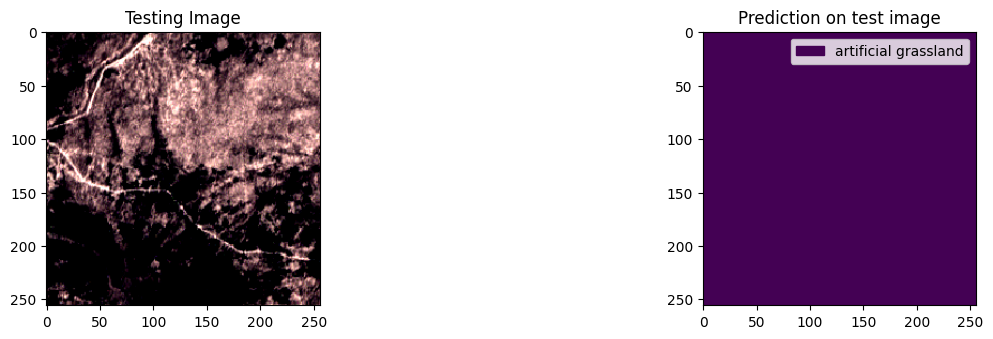

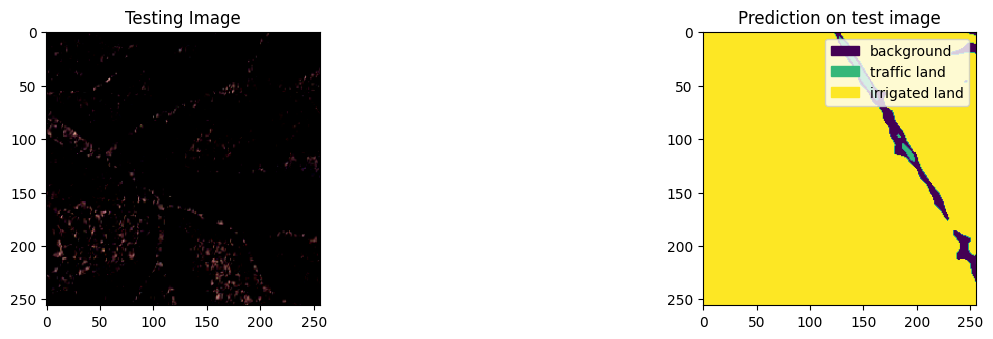

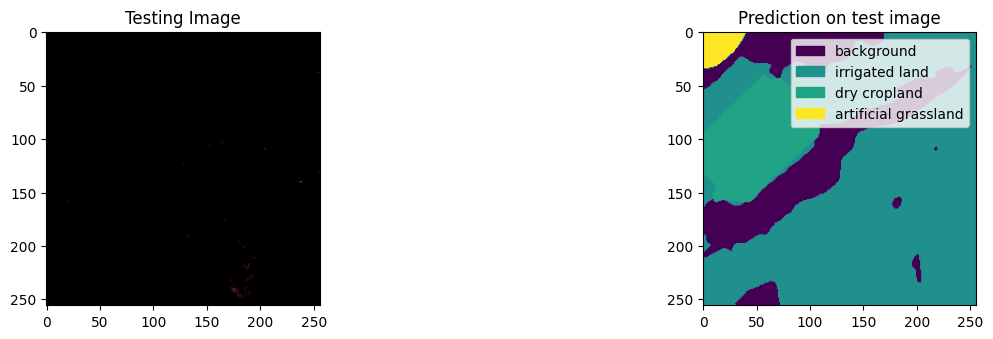

...

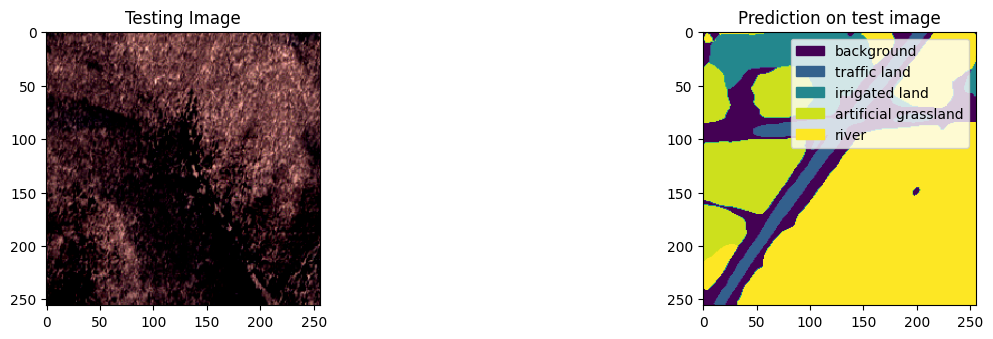

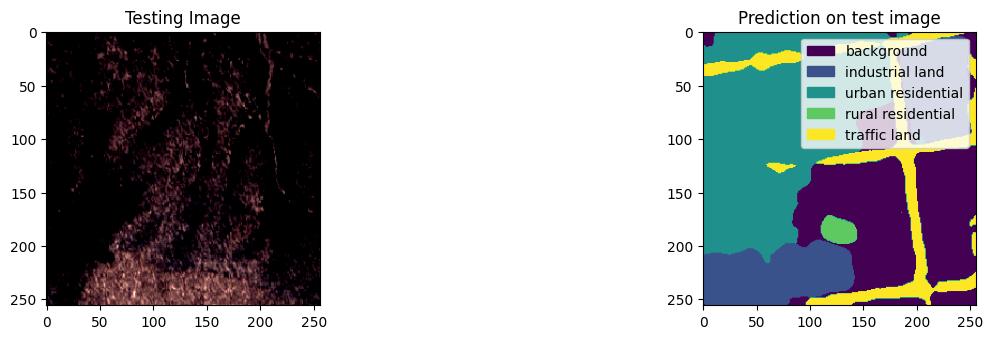

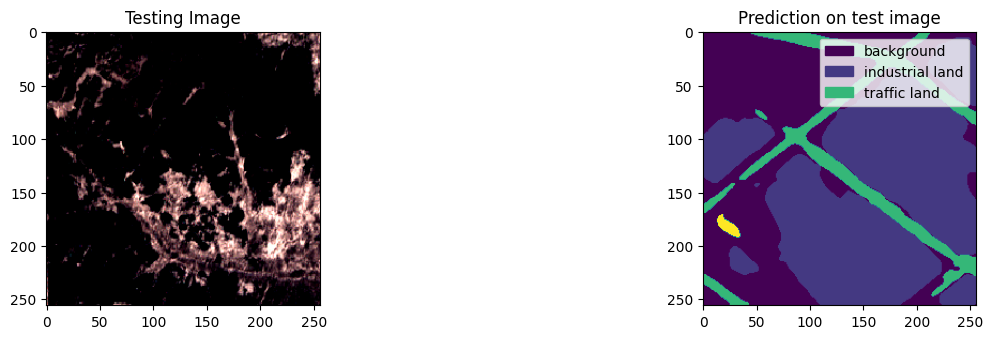

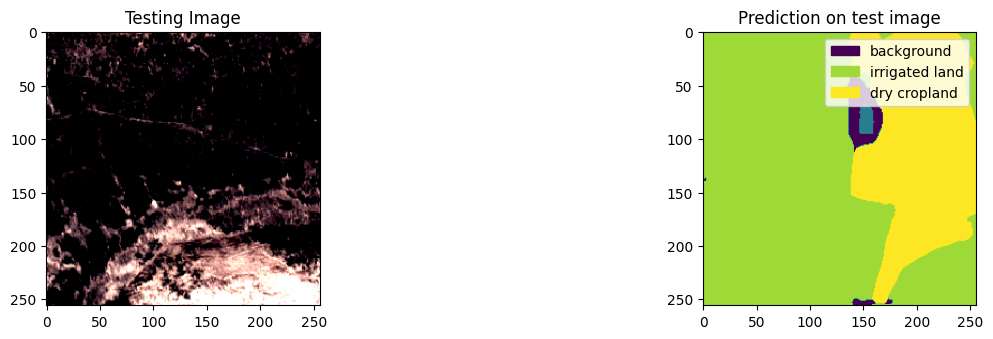

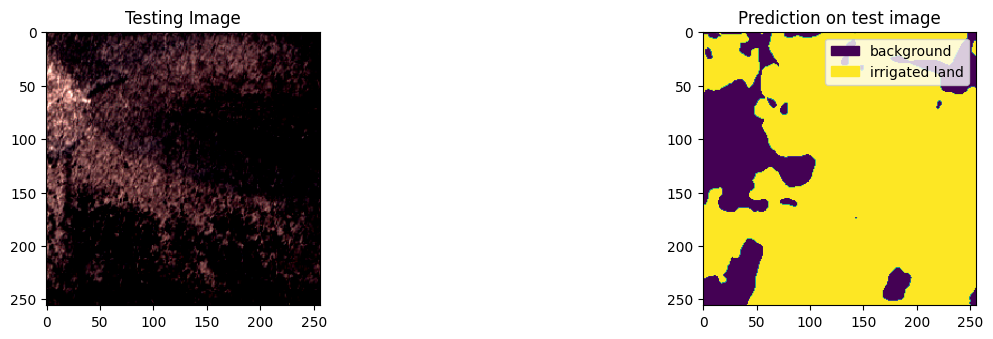

5
Found 64 images belonging to 1 classes.
Found 1 images belonging to 2 classes.
2/2 [==============================] - 20s 9s/step


64


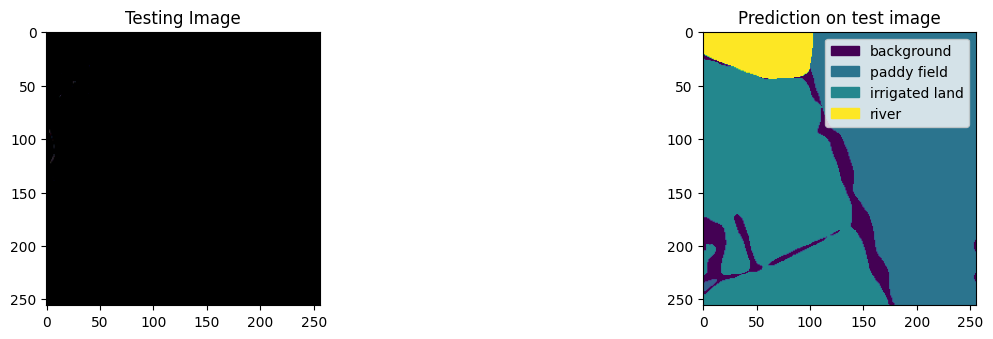

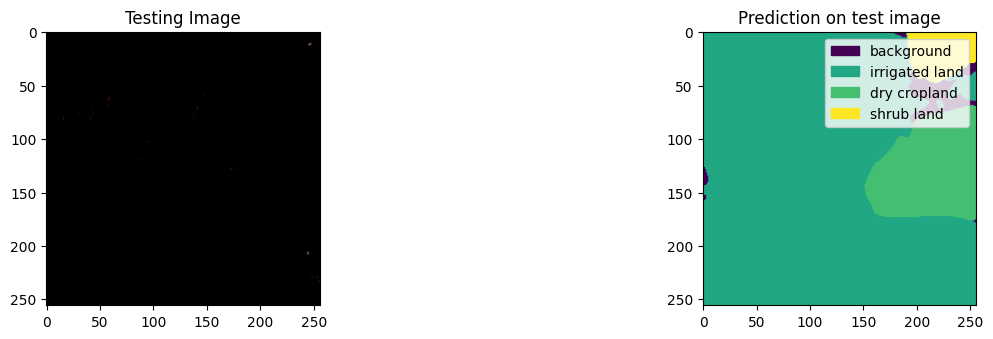

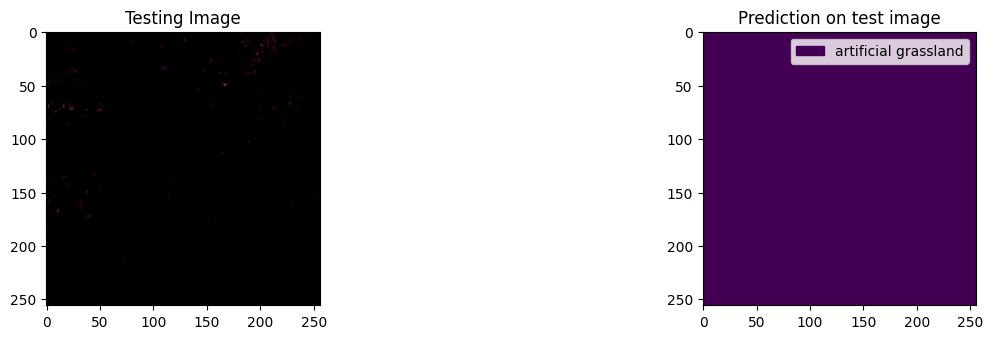

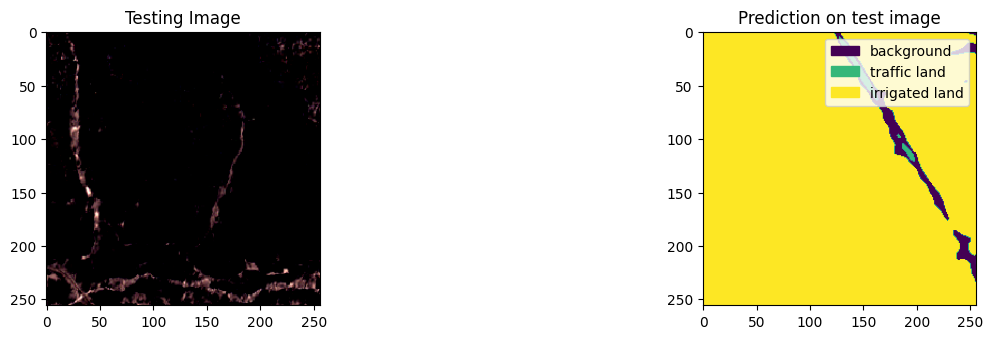

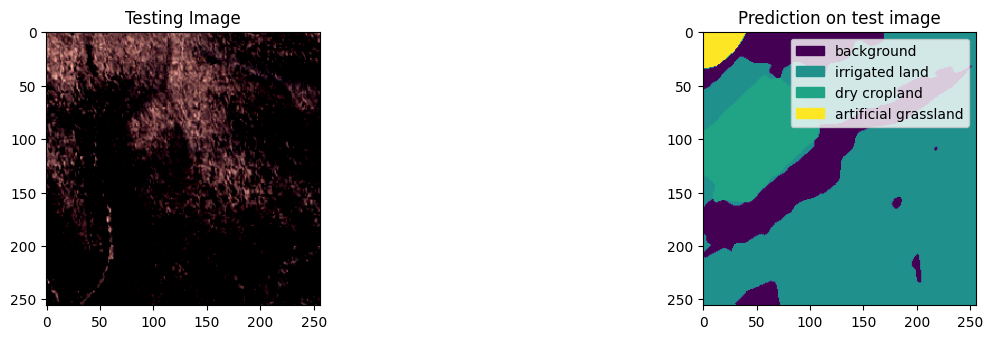

...

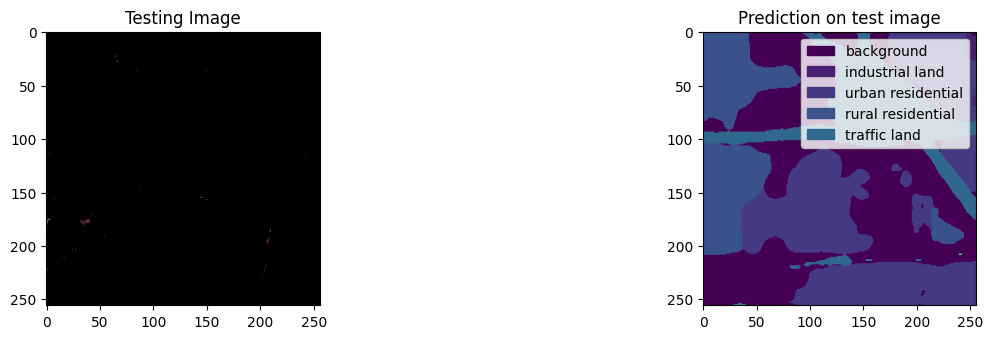

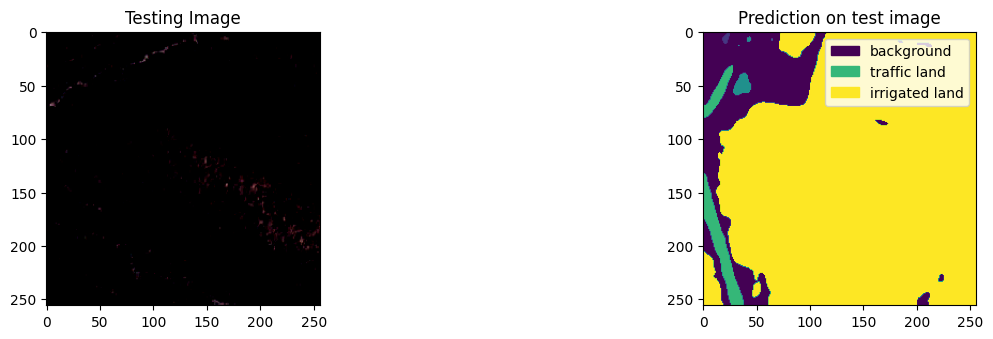

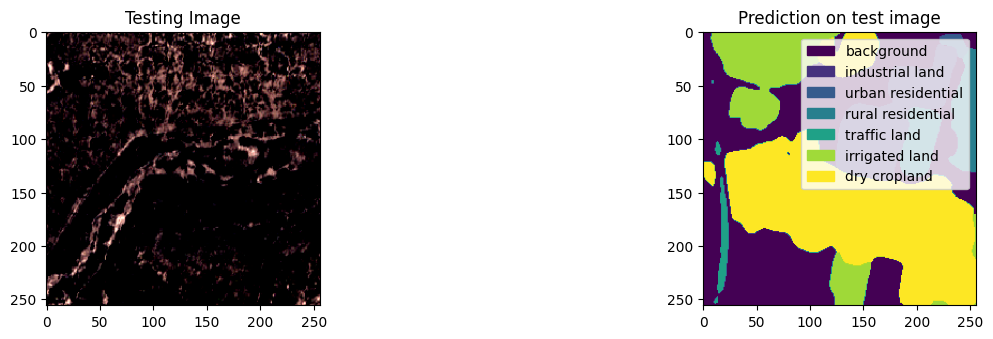

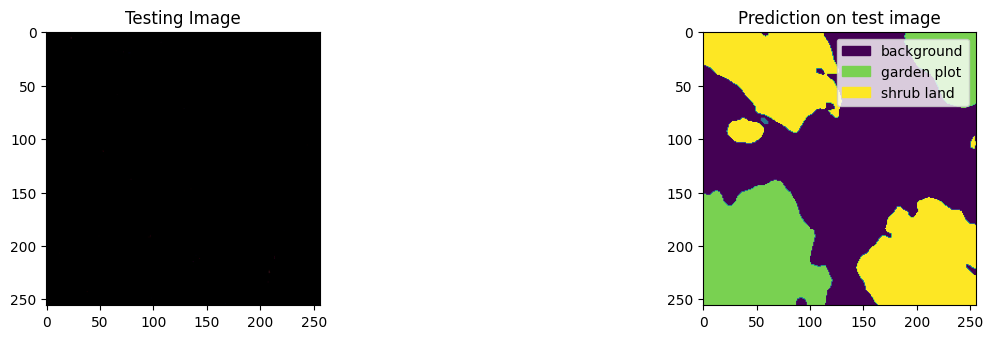

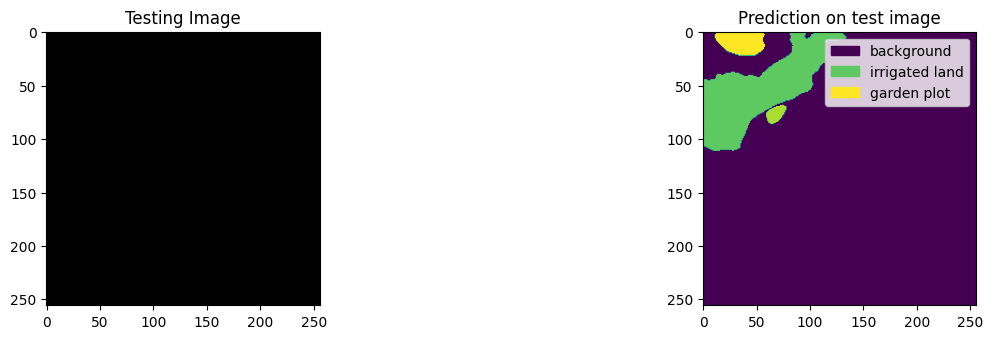

In [ ]:
nums = len(os.listdir("/content/drive/MyDrive/Colab Notebooks/8"))
Sd="/content/drive/MyDrive/rez1/image"
for i in range(1,nums):
 print(i)
 eval_preds_img_gen = trainGenerator1(f"/content/drive/MyDrive/Colab Notebooks/8/{i}","1", num_class=N_CLASSES)
 test_image_batch, test_mask_batch = eval_preds_img_gen.__next__()
 test_pred_batch = model.predict(test_image_batch)
 s=len(test_pred_batch_argmax)
 print(s)
#  x, y = show_examples(eval_preds_img_gen)
 for j in range(s):
 
  # print(j)
  # cv2.imwrite(f"/content/drive/MyDrive/rez12/{i}image{j}.tif",test_pred_batch_argmax[j])
  combined_data = np.array( list(np.unique(test_pred_batch_argmax[j])))
  _min, _max = np.amin(combined_data), np.amax(combined_data)
  plt.figure(figsize=(12, 8))
  plt.subplot(231)
  plt.title('Testing Image')
  plt.imshow(test_image_batch[j])
  plt.subplot(233)
  plt.title('Prediction on test image')
  plt.imshow(test_pred_batch_argmax[j], cmap='viridis')
  show_mask_with_label(test_pred_batch_argmax[j], labels, _min, _max)
  
  plt.show()


In [ ]:

# This is a sample Python script.
import os

import torch
# import torchvision
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
# from sklearn.model_selection import train_test_split
from os import listdir
from typing import Tuple, List, Dict, Generator, Any


Image.MAX_IMAGE_PIXELS = None


def get_subimages_generator(
        image: Image.Image,
        subimage_size: Tuple[int, int, int]
) -> Generator[Image.Image, None, None]:
    for r in range(image.size[1] // subimage_size[1]):
        for c in range(image.size[0] // subimage_size[0]):
            yield image.crop(box=(
                c * subimage_size[0],
                r * subimage_size[1],
                (c + 1) * subimage_size[0],
                (r + 1) * subimage_size[1]
            )
            )


s = "C:/Users/jet/Desktop/fd/56.tif"


def save_dataset_subimages(classes_filter: Dict[Tuple[int, int, int], float]):
    image = Image.open("C:/Users/jet/Desktop/121.tif").crop(box=(16, 40, 7200 - 16, 6800 - 40))

    subimages = get_subimages_generator(image=image, subimage_size=(256, 256))
    # subimages_labeleds = get_subimages_generator(image=image_labeled, subimage_size=(224, 224))
    s = 0
    v = 1
    s='train'
    # for i in range(1, 13):
    #     os.mkdir(f'C:/Users/jet/Desktop/11/{i}')

    for si, subimage in enumerate(subimages):
        # print(subimage)
        # s+=1
        # for i in range(1,1000):
        if si <= 64:
            subimage.save(f'C:/Users\jet/Desktop/8/1/train/isi{si}.tif')
            # os.mkdir(f'C:/Users\jet/Desktop/11/1/{si}.tif')
        elif si >= 65 and 128 >= si:
            subimage.save(f'C:/Users\jet/Desktop/8/2/train/isi{si}.tif')
        elif si >= 129 and 192 >= si:
            subimage.save(f'C:/Users\jet/Desktop/8/3/train/isi{si}.tif')
        elif si >= 193 and 256 >= si:
            subimage.save(f'C:/Users\jet/Desktop/8/4/train/isi{si}.tif')

        elif si >= 257 and 320 >= si:
            subimage.save(f'C:/Users\jet/Desktop/8/5/train/isi{si}.tif')

        elif si >= 321 and 384 >= si:
            subimage.save(f'C:/Users\jet/Desktop/8/6/train/isi{si}.tif')

        elif si >= 385 and 448 >= si:
            subimage.save(f'C:/Users\jet/Desktop/8/7/train/isi{si}.tif')

        elif si >= 449 and 512 >= si:
            subimage.save(f'C:/Users\jet/Desktop/8/8/train/isi{si}.tif')

        elif si >= 513 and 576 >= si:
            subimage.save(f'C:/Users\jet/Desktop/8/9/train/isi{si}.tif')

        elif si >= 577 and 611 >= si:
            subimage.save(f'C:/Users\jet/Desktop/8/10/train/isi{si}.tif')

        elif si >= 612 and 675 >= si:
            subimage.save(f'C:/Users\jet/Desktop/8/11/train/isi{si}.tif')

        elif si >= 676 and 727 >= si:
            subimage.save(f'C:/Users\jet/Desktop/8/12/train/isi{si}.tif')

        elif si >= 723 and 787 >= si:
            subimage.save(f'C:/Users\jet/Desktop/8/13/train/isi{si}.tif')

    # subimage.save(f'C:/Users\jet/Desktop/11/{0}/isi{si}.tif')


save_dataset_subimages(
    classes_filter={
        (150, 250, 0): 5
    }
)
